# 3 Outlier Removal

An outlier removal criteria will now be determined on the training set and applied to the training and test sets.

See https://journals.sagepub.com/doi/epub/10.1177/0967033519848296 for method used.

## Setup

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go

from scipy.stats import f
from sklearn.cross_decomposition import PLSRegression
from sklearn.decomposition import PCA
from sklearn.covariance import MinCovDet
from scipy.signal import savgol_filter

In [2]:
# read in prepared dataset from previous step
df = pd.read_pickle("data/interim/2_partitioned.pkl")
wavelength_cols = df.filter(regex="^\d+", axis=1).columns.tolist()
descriptive_cols = [col for col in df.columns if col not in wavelength_cols]
df

,partition_1,train_partition_1,partition_ext,origin,population,date,season,region,cultivar,physio_stage,...,1173,1176,1179,1182,1185,1188,1191,1194,1197,1200
0,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85396,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85397,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85398,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85399,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Apply basic pretreatment

Use pretreatment and wavelength range optimised for mango dmc application by Anderson 2020.

In [3]:
# apply Savitzky-Golay smoothing to the spectra
df_p = df.copy()
df_p[wavelength_cols] = df_p[wavelength_cols].apply(
    lambda row: savgol_filter(
        x=row,
        window_length=17,
        polyorder=2,
        deriv=2
    ),
    axis=1,
    result_type="expand"
)

# select wavelengths
selected_wavelengths = list(filter(lambda w: 684 <= int(w) <= 990, wavelength_cols))
df_p = df_p[
    descriptive_cols
    + selected_wavelengths
    ]

df_p

,partition_1,train_partition_1,partition_ext,origin,population,date,season,region,cultivar,physio_stage,...,963,966,969,972,975,978,981,984,987,990
0,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,-0.002284,-0.002370,-0.002319,-0.002167,-0.001931,-0.001664,-0.001437,-0.001224,-0.001095,-0.001008
1,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,-0.002294,-0.002360,-0.002297,-0.002137,-0.001910,-0.001666,-0.001444,-0.001268,-0.001123,-0.001012
2,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,-0.002539,-0.002598,-0.002525,-0.002361,-0.002106,-0.001810,-0.001529,-0.001289,-0.001107,-0.000965
3,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,-0.002556,-0.002625,-0.002556,-0.002374,-0.002111,-0.001816,-0.001539,-0.001298,-0.001104,-0.000962
4,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,-0.002185,-0.002249,-0.002183,-0.002017,-0.001790,-0.001559,-0.001321,-0.001120,-0.000987,-0.000940
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85396,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,-0.001942,-0.002023,-0.002006,-0.001882,-0.001695,-0.001485,-0.001276,-0.001108,-0.000975,-0.000870
85397,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,-0.001918,-0.002001,-0.001977,-0.001857,-0.001673,-0.001459,-0.001253,-0.001081,-0.000956,-0.000862
85398,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,-0.001908,-0.002009,-0.001995,-0.001893,-0.001723,-0.001529,-0.001336,-0.001169,-0.001036,-0.000922
85399,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,-0.002194,-0.002312,-0.002301,-0.002184,-0.001977,-0.001731,-0.001494,-0.001303,-0.001150,-0.001023


## Split partitions

In [4]:
X_train = df_p.query("partition_1 == 'train'")[selected_wavelengths].values
Y_train = df_p.query("partition_1 == 'train'")["dry_matter"].values
X_all = df_p[selected_wavelengths].values
Y_all = df_p["dry_matter"].values

## Calculate Metrics

Refer to [Outliers detection with PLS regression for NIR spectroscopy in Python](https://nirpyresearch.com/outliers-detection-pls-regression-nir-spectroscopy-python/).

PLS model for spectra defined as:

X = T × P<sup>T</sup> + E

Where:
- X: spectra (m samples × n wavelengths matrix)
- P: loadings matrix (n × k scores matrix)
- T: scores (m × k scores matrix)
- E: error (m × n matrix)


PLS model for response variable:

Y = U × Q<sup>T</sup> + F

Where:
- Y: responses (m samples × 1 wavelengths matrix)
- Q: loadings matrix (1 × k scores matrix)
- U: scores (m × k scores matrix)
- F: error (m × 1 matrix)

In [5]:
# create and fit PLS models with 11 LVs
n_components = 11 #TODO: optimise this
pls = PLSRegression(n_components=n_components, scale=False)
pls.fit(X=X_train, Y=Y_train)

# get pls loading for fitted model
P = pls.x_loadings_

# get pls scores for training set
T_train = pls.transform(X=X_train)
T = pls.transform(X=X_all)

# calculate error matrix
E = X_all - np.dot(T, P.T)

In [6]:
df_metrics = df_p[descriptive_cols].copy()

# calculate Mahalanobis distance
mcd = MinCovDet()
robust_cov = mcd.fit(X=T_train)
df_metrics["mahalanobis_distance"] = robust_cov.mahalanobis(X=T)

# calculate Global H (GH)
df_metrics["global_h"] = df_metrics["mahalanobis_distance"]/n_components

# calculate Q-residuals (sum over the rows of the error array)
df_metrics["q_residuals"] = np.sum(E**2, axis=1)

# calculate Hotelling's T-squared (note that data is normalised by default)
df_metrics["hotellings_t_squared"] = np.sum(
    (T / np.std(T_train, axis=0))**2,
    axis=1
)

## Decide Outlier Criteria

Will examine an outlier criteria based on the training set

In [7]:
def lower_bound(htsq: float) -> float:
    """The lower bound for Q-residuals as a function of Hotelling's T-squared

    Args:
        htsq: Hotelling's T-squared

    Returns:
        The lower bound for the Q-residual
    """
    return 589.37 * 1e-6 + htsq * 0.002 * 1e-6

def upper_bound(htsq: float) -> float:
    """The upper bound for Q-residuals as a function of Hotelling's T-squared

    Args:
        htsq: Hotelling's T-squared

    Returns:
        The upper bound for the Q-residual
    """
    return 589.9 * 1e-6 + htsq * -0.003 * 1e-6

max_hotellings_t_squared = 42

In [8]:
# plot of Hotelling's T-squared vs Q-residuals
fig = px.scatter(
    data_frame=df_metrics.query("partition_1 == 'train'"),
    x="hotellings_t_squared",
    y="q_residuals",
    # color="season",
    color="population",
    size_max=20,
    title="Interactive Scatter Plot",
    hover_data=["spectra_no", "season", "instrument", "population"]
)

# add boundary lines for outliers
x_values = np.linspace(
    start=df_metrics["hotellings_t_squared"].min(),
    stop=max_hotellings_t_squared,
    num=100
)
fig.add_trace(
    px.line(
        x=x_values,
        y=lower_bound(x_values),
    ).update_traces(line_color="red").data[0],
)
fig.add_trace(
    px.line(
        x=x_values,
        y=upper_bound(x_values),
    ).update_traces(line_color="red").data[0],
)

fig.add_trace(
    px.line(
        x=[max_hotellings_t_squared]*2,
        y=[lower_bound(max_hotellings_t_squared), upper_bound(max_hotellings_t_squared)]
    ).update_traces(line_color="red").data[0],
)

# show the plot
# fig.update_layout(height=800)
fig.show()

## Flag Outliers and analyse

In [9]:
# remove outliers

# calculate the y-values for each sample at boundary line
lower_bound_values = lower_bound(df_metrics["hotellings_t_squared"])
upper_bound_values = upper_bound(df_metrics["hotellings_t_squared"])

# Filter the DataFrame based on the conditions defined by the lines
df_metrics["outlier_flag_1"] = 1
df_metrics.loc[
    (df_metrics["q_residuals"]  < upper_bound_values) &
    (df_metrics["q_residuals"] > lower_bound_values) &
    (df_metrics["hotellings_t_squared"] < max_hotellings_t_squared),
    "outlier_flag_1"
] = 0

outlier_count = df_metrics.groupby(["partition_1"])["outlier_flag_1"].agg(["count", "sum"]).reset_index()
outlier_count["pct_outliers"] = outlier_count["sum"]/outlier_count["count"]
outlier_count

,partition_1,count,sum,pct_outliers
0,holdout,5842,264,0.045190
1,train,57822,1131,0.019560
2,validation,21737,2066,0.095045


In [10]:
# percentage flagged outliers by group
group = ["instrument"]
outlier_count = df_metrics.groupby(group)["outlier_flag_1"].agg(["count", "sum"]).reset_index()
outlier_count["pct_outliers"] = outlier_count["sum"]/outlier_count["count"]
outlier_count.sort_values(by="pct_outliers", ascending=False)

,instrument,count,sum,pct_outliers
15,16034,428,299,0.698598
25,18029,2022,474,0.234421
22,17057,2570,492,0.191440
17,16048,2466,440,0.178427
21,17052,2244,332,0.147950
16,16041,4672,307,0.065711
19,17033,3816,196,0.051363
24,18022,264,13,0.049242
28,20013,124,5,0.040323
1,15006,15040,548,0.036436


In [11]:
# plot of Hotelling's T-squared vs Q-residuals
fig = px.scatter(
    data_frame=df_metrics,
    x="hotellings_t_squared",
    y="q_residuals",
    color="partition_1",
    size_max=20,
    title="Filtered Interactive Scatter Plot",
    hover_data=["spectra_no", "season", "instrument", "population", "outlier_flag_1"]
)

# add boundary lines for outliers
x_values = np.linspace(
    start=df_metrics["hotellings_t_squared"].min(),
    stop=max_hotellings_t_squared,
    num=100
)
fig.add_trace(
    px.line(
        x=x_values,
        y=lower_bound(x_values),
    ).update_traces(line_color="red").data[0],
)
fig.add_trace(
    px.line(
        x=x_values,
        y=upper_bound(x_values),
    ).update_traces(line_color="red").data[0],
)
fig.add_trace(
    px.line(
        x=[max_hotellings_t_squared]*2,
        y=[lower_bound(max_hotellings_t_squared), upper_bound(max_hotellings_t_squared)]
    ).update_traces(line_color="red").data[0],
)

# show the plot
# fig.update_layout(height=800)
fig.show()

## Plot for Manuscript

Create a plot to go in the methods of upcoming manuscript.

In [12]:
df_train = df_metrics.query("partition_1 == 'train'")
df_test = df_metrics.query("partition_1 != 'train'")

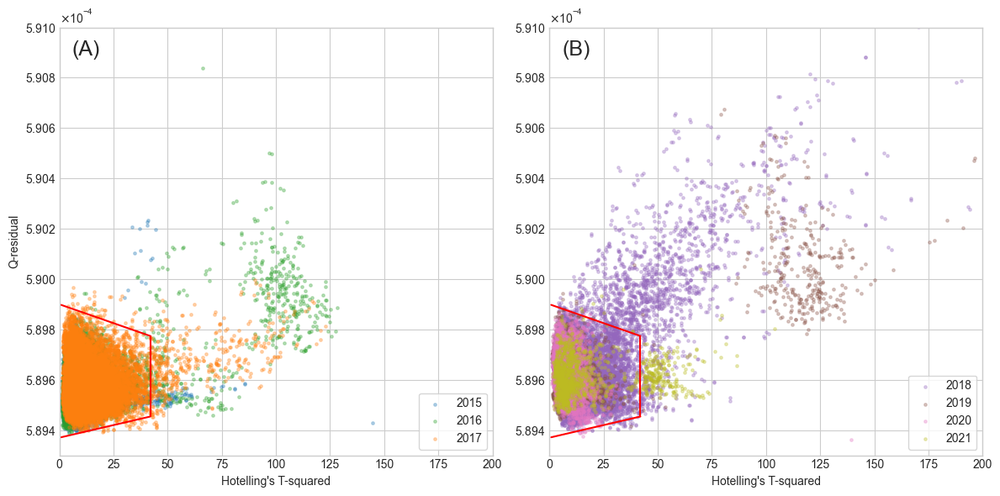

In [13]:
# PLOT for manuscript

import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter

plt.style.use('seaborn-v0_8-whitegrid')
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

colour_map = {
    2015: "#1f77b4",
    2016: "#2ca02c",
    2017: "#ff7f0e",
    2018: "#9467bd",
    2019: "#8c564b",
    2020: "#e377c2",
    2021: "#bcbd22"
}

# creating the scatter plot for (A)
for season in df_train['season'].unique():
    season_data = df_train[df_train['season'] == season]
    axs[0].scatter(season_data['hotellings_t_squared'], season_data['q_residuals'], label=season, s=6, alpha=0.3, color=colour_map[season])

# creating the scatter plot for (B)
for season in df_test['season'].unique():
    season_data = df_test[df_test['season'] == season]
    axs[1].scatter(season_data['hotellings_t_squared'], season_data['q_residuals'], label=season, s=6, alpha=0.3, color=colour_map[season])

# adding boundary lines for outliers

for axis in [0, 1]:
    x_values = np.linspace(df_metrics["hotellings_t_squared"].min(), max_hotellings_t_squared, 100)
    axs[axis].plot(x_values, lower_bound(x_values), color="red")
    axs[axis].plot(x_values, upper_bound(x_values), color="red")
    x_values_2 = np.linspace(73.2, max_hotellings_t_squared, 100)
    axs[axis].plot(
        [max_hotellings_t_squared, max_hotellings_t_squared], 
        [lower_bound(max_hotellings_t_squared), upper_bound(max_hotellings_t_squared)], 
        color="red"
    )

# setting the title and labels
axs[0].set_xlabel("Hotelling's T-squared")
axs[1].set_xlabel("Hotelling's T-squared")
axs[0].set_ylabel("Q-residual")
axs[0].legend(title="Season")
axs[1].legend(title="Season")

# Apply scientific notation to y-axis
y_formatter = ScalarFormatter(useMathText=True)
y_formatter.set_powerlimits((-3, 3))
for axis in [0, 1]:
    axs[axis].yaxis.set_major_formatter(y_formatter)
    axs[axis].set_xlim(0, 200)
    axs[axis].set_ylim(5.893*10**(-4), 5.91*10**(-4))
    axs[axis].legend(loc="lower right", frameon=True)
    
#
axs[0].text(0.03, 0.97, '(A)', transform=axs[0].transAxes, fontsize=18, verticalalignment='top')
axs[1].text(0.03, 0.97, '(B)', transform=axs[1].transAxes, fontsize=18, verticalalignment='top')

# showing the plot
plt.tight_layout()
plt.show()

## Flag Populations with large number of outliers

In [14]:
df_metrics.groupby(["outlier_flag_1"]).size()

outlier_flag_1
0    81940
1     3461
dtype: int64

In [15]:
# calculate percentage outliers per population 
outlier_count = df_metrics.groupby("population")["outlier_flag_1"].agg(["count", "sum"]).reset_index()
outlier_count["pct_outliers"] = outlier_count["sum"]/outlier_count["count"]

# flag populations with large percentage of outliers
pops_high_outliers = outlier_count[outlier_count["pct_outliers"] > 0.2]["population"].to_list()


# calculate percentage outliers per instrument 
outlier_count = df_metrics.groupby("instrument")["outlier_flag_1"].agg(["count", "sum"]).reset_index()
outlier_count["pct_outliers"] = outlier_count["sum"]/outlier_count["count"]

# flag instruments with large percentage of outliers
instrument_high_outliers = outlier_count[outlier_count["pct_outliers"] > 0.2]["instrument"].to_list()

# flag samples
df_metrics_2 = df_metrics.copy()
# df_metrics_2.loc[
#     (df_metrics_2["population"].isin(pops_high_outliers)) & (df_metrics_2["instrument"].isin(instrument_high_outliers)) & (df_metrics_2["outlier_flag_1"] == 0),
#     "outlier_flag_1"
# ] = 2
df_metrics_2.loc[
    (df_metrics_2["population"].isin(pops_high_outliers)) & (df_metrics_2["outlier_flag_1"] == 0),
    "outlier_flag_1"
] = 2
# df_metrics_2.loc[
#     (df_metrics_2["instrument"].isin(instrument_high_outliers)) & (df_metrics_2["outlier_flag_1"] == 0),
#     "outlier_flag_1"
# ] = 4

df_metrics_2.groupby("outlier_flag_1").size()

outlier_flag_1
0    78159
1     3461
2     3781
dtype: int64

## Perform PCA

In [16]:
# fit PCA on training data
pca = PCA(n_components=7)
# TODO: should standard scalar be applied before fitting pca
pca.fit(X=X_train)

# apply dimensionality reduction
pc_scores = pca.transform(X=X_all)

# create a DataFrame with principal component scores
pc_scores = pd.DataFrame(pc_scores)
pc_columns = [f"PC{i + 1}" for i in range(pca.n_components)]
pc_scores.columns = pc_columns

# add metta data back in
pc_scores["spectra_no"] = df_metrics_2["spectra_no"]
pc_scores = df_metrics.merge(pc_scores, on="spectra_no")
pc_scores

,partition_1,train_partition_1,partition_ext,origin,population,date,season,region,cultivar,physio_stage,...,q_residuals,hotellings_t_squared,outlier_flag_1,PC1,PC2,PC3,PC4,PC5,PC6,PC7
0,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,0.000590,7.877285,0,-0.008980,0.000906,-0.000139,-0.000693,-0.000734,-0.000429,0.000336
1,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,0.000590,8.309454,0,-0.009172,0.000779,-0.000253,-0.000703,-0.000727,-0.000386,0.000390
2,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,0.000590,9.736595,0,-0.009943,0.000706,-0.000987,-0.001311,-0.001222,0.000246,0.000338
3,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,0.000589,10.152798,0,-0.010123,0.000598,-0.001080,-0.001349,-0.001197,0.000271,0.000351
4,train,calibration,train,published,100100,2015-09-27,2015,NT,caly,green,...,0.000590,9.889514,0,-0.008864,0.005912,0.000305,-0.000495,-0.000783,-0.000289,0.000194
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85396,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.000590,10.085512,0,0.005190,-0.003749,-0.001200,0.000800,0.001110,0.000375,-0.000228
85397,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.000590,7.438466,0,0.002461,-0.006421,-0.000029,0.001081,0.000963,-0.000076,-0.000198
85398,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.000590,17.108610,0,-0.002393,-0.003820,-0.000953,0.000685,0.000685,-0.000149,-0.000221
85399,holdout,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.000590,18.312080,0,0.006000,-0.004191,-0.001221,-0.000170,0.001480,0.000430,-0.000362


In [17]:
# interactive plot
fig = px.scatter(
    data_frame=pc_scores,
    x="PC1",
    y="PC2",
    color="outlier_flag_1",
    # symbol="partition_1",
    size_max=20,
    title="Interactive Scatter Plot",
    hover_data=["partition_1", "instrument", "population", "temp"]
)
fig.update_layout(height=800)

# Show the plot
fig.show()

## Output data

In [18]:
# create outlier flag column
outlier_flag = df_metrics_2.query("outlier_flag_1 != 0")[["spectra_no", "outlier_flag_1"]]
df_outliers_flagged = df.merge(
    right=outlier_flag,
    on="spectra_no",
    how="left"
)

# move the "outlier_flag_1" column to position 1
outlier_flag_1_col = df_outliers_flagged.pop("outlier_flag_1").fillna(0).astype(int)
df_outliers_flagged.insert(1, "outlier_flag_1", outlier_flag_1_col)

df_outliers_flagged

,partition_1,outlier_flag_1,train_partition_1,partition_ext,origin,population,date,season,region,cultivar,...,1173,1176,1179,1182,1185,1188,1191,1194,1197,1200
0,train,0,calibration,train,published,100100,2015-09-27,2015,NT,caly,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,train,0,calibration,train,published,100100,2015-09-27,2015,NT,caly,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,train,0,calibration,train,published,100100,2015-09-27,2015,NT,caly,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,train,0,calibration,train,published,100100,2015-09-27,2015,NT,caly,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,train,0,calibration,train,published,100100,2015-09-27,2015,NT,caly,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85396,holdout,0,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85397,holdout,0,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85398,holdout,0,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85399,holdout,0,calibration,train,marcelo,200800,NaT,2021,QLD,keitt,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [19]:
df_outliers_flagged.groupby("outlier_flag_1").size()

outlier_flag_1
0    78159
1     3461
2     3781
dtype: int64

In [20]:
# output
df_outliers_flagged.to_pickle("data/interim/3_outliers_flagged.pkl")